In [13]:
using Revise  # auto reload

includet("State_Space_Model.jl")
using .state_space_model

includet("Kalman.jl")
using .kalman

includet("MCMC.jl")
using .MCMC

using Random
using LinearAlgebra
using Statistics
using Distributions
using ProgressMeter
using SpecialFunctions
using Plots


In [ ]:
# Parameters in θ
# θ_elements = ["ρ", "λ_c", "c₁", "c₂", "v_ε, y", "v_ξ, y", "v_κ, y", "σ²_ε, y", "σ²_ξ, y", "σ²_κ, y", "σ²_ε, π", "σ²_ξ, π", "σ²_κ, π"]
θ_elements = ["ρ", "λ_c", "c₁", "c₂", "σ²_ε, y", "σ²_ξ, y", "σ²_κ, y", "σ²_ε, π", "σ²_ξ, π", "σ²_κ, π"]

n_params = length(θ_elements)

# List of prior distributions 
prior_distributions = (
    "uniform", # ρ
    "uniform", # λ_c
    "uniform", # c₁
    "uniform", # c₂
    "uniform", # σ²_ε, y
    "uniform", # σ²_ξ, y
    "uniform", # σ²_κ, y
    "uniform", # σ²_ε, π
    "uniform", # σ²_ξ, π
    "uniform", # σ²_κ, π
    )

# matrix of prior hyperparameters.
prior_hyperparameters = [ 
    0.001 0.99; # ρ
    0.001 3.0; # λ_c
    0.0 1.0; # c₁
    0.0 1.0; # c₂
    0.0 1.0; # σ²_ε, y
    0.0 1.0; # σ²_ξ, y
    0.0 1.0; # σ²_κ, y
    0.0 1.0; # σ²_ε, π
    0.0 1.0; # σ²_ξ, π
    0.0 1.0; # σ²_κ, π
    ]


# Create the support matrix in the same way.
support = [
    0.0 1.0; # ρ
    0.0 3.0; # λ_c
    0.0 1.0; # c₁
    0.0 1.0; # c₂
    0.0 Inf; # σ²_ε, y
    0.0 Inf; # σ²_ξ, y
    0.0 Inf; # σ²_κ, y
    0.0 Inf; # σ²_ε, π
    0.0 Inf; # σ²_ξ, π
    0.0 Inf; # σ²_κ, π
    ]


# Combine into a named tuple
prior_info = (
    support = support,
    distributions = prior_distributions,
    parameters = prior_hyperparameters,
)



#States in α
α_elements = [
    "u_t^y", 
    "β_t^y", 
    "u_t^π", 
    "β_t^π", 
    "ψ_{2,t}^y", 
    "ψ_{2,t}^{y*}", 
    "ψ_{1,t}^y", 
    "ψ_{1,t}^{y*}", 
    "ψ_{2,t}^π", 
    "ψ_{2,t}^{π*}", 
    "ψ_{1,t}^π", 
    "ψ_{1,t}^{π*}", 
    "tilde{ψ}_t^y", 
    "tilde{ψ}_{t-1}^y"
]


# True parameters
ρ = 0.7
λ_c = 0.5
c₁ = 0.7
c₂ = 0.02
# v_ε = -0.028*10e-7
# v_ξ = -0.22*10e-7
# v_κ = 0.04*10e-7
# σ²_ε_y = 40*10e-7
# σ²_ξ_y = 26*10e-7
# σ²_κ_y = 272*10e-7
# σ²_ε_π = 5241*10e-7
# σ²_ξ_π = 5.97*10e-7
# σ²_κ_π = 112.5*10e-7
σ²_ε_y = 0.02
σ²_ξ_y = 0.05
σ²_κ_y = 0.01
σ²_ε_π = 0.09
σ²_ξ_π = 0.001
σ²_κ_π = 0.002


# θ_true = [ρ, λ_c, c₁, c₂, v_ε, v_ξ, v_κ, σ²_ε_y, σ²_ξ_y, σ²_κ_y, σ²_ε_π, σ²_ξ_π, σ²_κ_π]
θ_true = [ρ, λ_c, c₁, c₂, σ²_ε_y, σ²_ξ_y, σ²_κ_y, σ²_ε_π, σ²_ξ_π, σ²_κ_π]

# cycle_order
cycle_order = 2

2

In [15]:
Z,H,T,R,Q,P_diffuse = state_space(θ_true, cycle_order, [1,1])
println("Z = ", Z)
println("H = ", H)
println("T = ", T)
println("R = ", R)
println("Q = ", Q)
println("P_diffuse = ", P_diffuse)

# Print shapes
println("Z shape: ", size(Z))
println("H shape: ", size(H))
println("T shape: ", size(T))
println("R shape: ", size(R))
println("Q shape: ", size(Q))
println("P_diffuse shape: ", size(P_diffuse))

Z = [1.0 0.0 0.0 0.0 1.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 1.0 0.0 0.0 0.0 0.0 0.0 1.0 0.0 0.0 0.0 0.7 0.02]
H = [0.02 0.0; 0.0 0.09]
T = [1.0 1.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 1.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 1.0 1.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 1.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.6143077933232609 0.3355978770229421 1.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0 -0.3355978770229421 0.6143077933232609 0.0 1.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.0 0.0 0.6143077933232609 0.3355978770229421 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.0 0.0 -0.3355978770229421 0.6143077933232609 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.6143077933232609 0.3355978770229421 1.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 -0.3355978770229421 0.6143077933232609 0.0 1.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.6143077933232609 0.3355978770229421 0.0 0.0; 0.0 0.0 0.

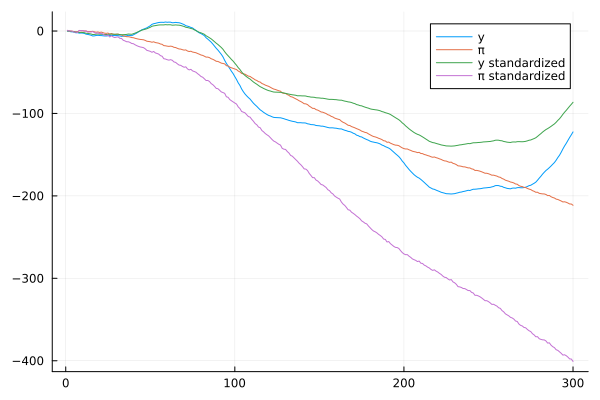

[1.4156371335695623, 0.5274587848269261]


14×14 Matrix{Bool}:
 1  0  0  0  0  0  0  0  0  0  0  0  0  0
 0  1  0  0  0  0  0  0  0  0  0  0  0  0
 0  0  1  0  0  0  0  0  0  0  0  0  0  0
 0  0  0  1  0  0  0  0  0  0  0  0  0  0
 0  0  0  0  1  0  0  0  0  0  0  0  0  0
 0  0  0  0  0  1  0  0  0  0  0  0  0  0
 0  0  0  0  0  0  1  0  0  0  0  0  0  0
 0  0  0  0  0  0  0  1  0  0  0  0  0  0
 0  0  0  0  0  0  0  0  1  0  0  0  0  0
 0  0  0  0  0  0  0  0  0  1  0  0  0  0
 0  0  0  0  0  0  0  0  0  0  1  0  0  0
 0  0  0  0  0  0  0  0  0  0  0  1  0  0
 0  0  0  0  0  0  0  0  0  0  0  0  1  0
 0  0  0  0  0  0  0  0  0  0  0  0  0  1

In [16]:
n_obs = 300

#simulate data
obs, α = simulate_data(θ_true, cycle_order, n_obs)

obs_std, σʸ = standardize_data(obs)
println(σʸ)

# obs_std = obs
# σʸ = 1.0

y = obs[1,:]
π = obs[2,:]
y_std = obs_std[1,:]
π_std = obs_std[2,:]

# plot data
plot(y, label="y")
plot!(π, label="π")
plot!(y_std, label="y standardized")   
plot!(π_std, label="π standardized")
display(plot!())


α0 = zeros(size(T, 1))
P0 = Matrix(I, size(T, 1), size(T, 1))  # large initial uncertainty



## MCMC

In [17]:
# True parameters
ρ = 0.7
λ_c = 0.5
c₁ = 0.7
c₂ = 0.02
# v_ε = -0.028*10e-7
# v_ξ = -0.22*10e-7
# v_κ = 0.04*10e-7
# σ²_ε_y = 40*10e-7
# σ²_ξ_y = 26*10e-7
# σ²_κ_y = 272*10e-7
# σ²_ε_π = 5241*10e-7
# σ²_ξ_π = 5.97*10e-7
# σ²_κ_π = 112.5*10e-7
σ²_ε_y = 0.02
σ²_ξ_y = 0.05
σ²_κ_y = 0.01
σ²_ε_π = 0.09
σ²_ξ_π = 0.001
σ²_κ_π = 0.002


# θ_true = [ρ, λ_c, c₁, c₂, v_ε, v_ξ, v_κ, σ²_ε_y, σ²_ξ_y, σ²_κ_y, σ²_ε_π, σ²_ξ_π, σ²_κ_π]
θ_true = [ρ, λ_c, c₁, c₂, σ²_ε_y, σ²_ξ_y, σ²_κ_y, σ²_ε_π, σ²_ξ_π, σ²_κ_π]

10-element Vector{Float64}:
 0.7
 0.5
 0.7
 0.02
 0.02
 0.05
 0.01
 0.09
 0.001
 0.002

In [18]:
θ_0 = [0.5, 0.8, 0.2, 0.5, 0.2, 0.0001, 0.1, 0.05, 0.1, 0.05]

θ_chain, θ_chain_init, α_draws = MCMC_estimation(obs_std, prior_info, α0, P0, cycle_order, σʸ;
 iter_init = 40000, 
 burn_init = 30000,
 iter_rec = 30000,
burn_rec = 20000,
θ_init = θ_0,
ω = 0.1)

Initialization Phase 100%|███████████████████████████████| Time: 0:01:45K


Initialization Acceptance Rate: 29.65%


Recursion Phase 100%|████████████████████████████████████| Time: 0:04:41


Recursion Acceptance Rate: 30.72666666666667%


([0.6096052882582312 0.4411652063619758 … 0.002793052292891343 0.007301275638387825; 0.5695249008590814 0.25161927772271026 … 0.0023896539229678704 0.01272187560166628; … ; 0.35059909929603345 0.2862974381016237 … 0.00284555658688562 0.4359932035188313; 0.40832273656611884 0.1421679229201529 … 0.002751122367967541 0.6432414045498139], [0.5 0.7999999999999998 … 0.10000000000000002 0.05000000000000001; 0.46251111673555295 0.8388141360102792 … 0.09116667283874531 0.07700383514395304; … ; 0.42294198729783 0.4011029258384811 … 0.0026792703261193022 0.08987698050918504; 0.42294198729783 0.4011029258384811 … 0.0026792703261193022 0.08987698050918504], [2.3567604964787794 -0.6252170948484518 … -1.3597890820610645 -0.46103915249511995; 0.35890808862213275 -0.5491059031286702 … -0.5297330678604056 0.5179776136763344; … ; 1.2563063757011343 -0.6490905524100736 … 0.8304866233305057 0.14210569626718894; 0.23529895379912702 -0.6947301910313664 … 1.180800925905498 -1.0235831310611816;;; 1.73154340163

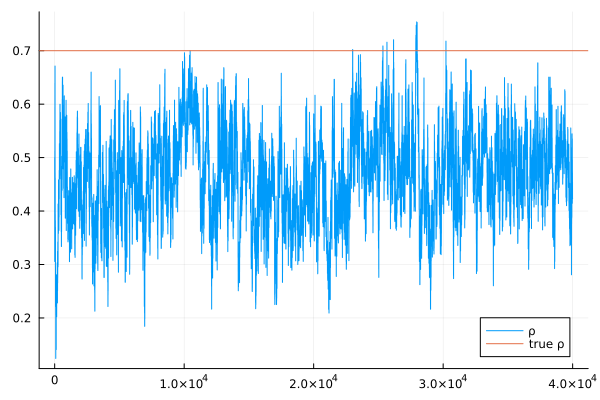

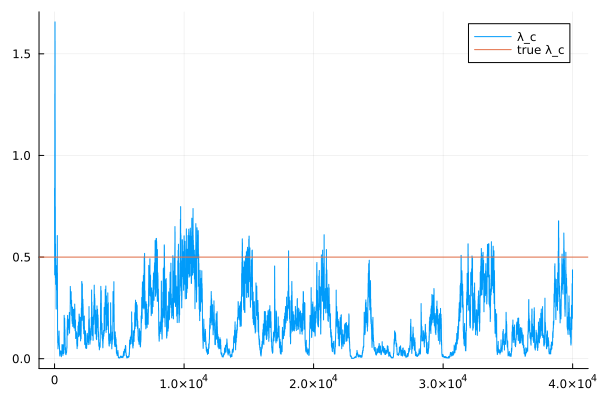

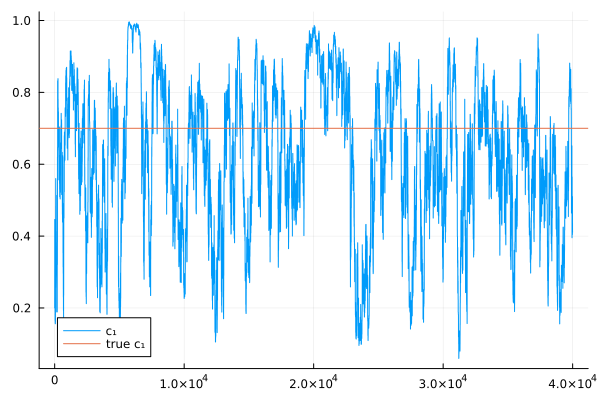

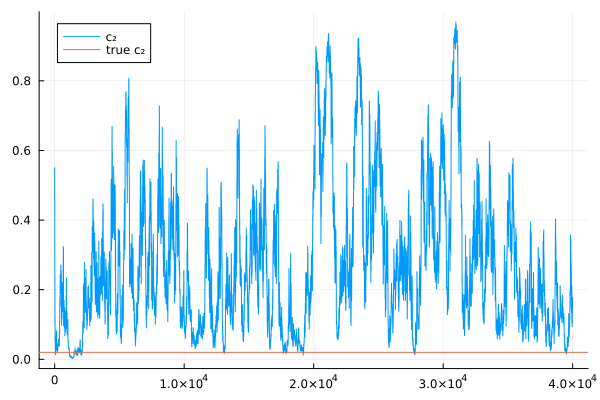

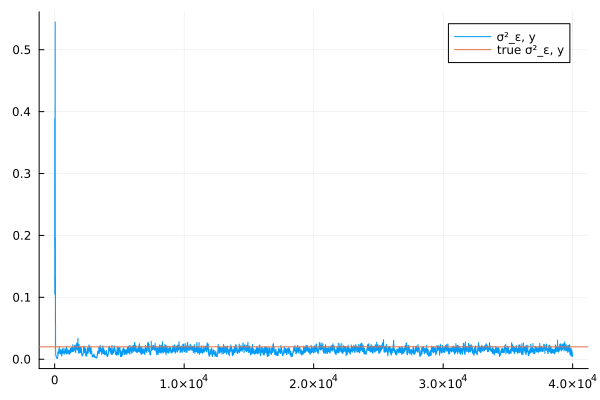

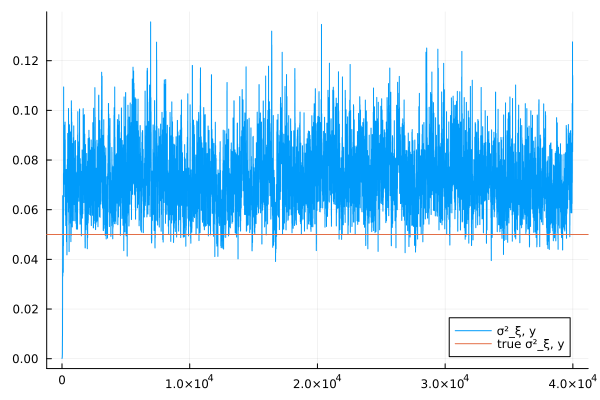

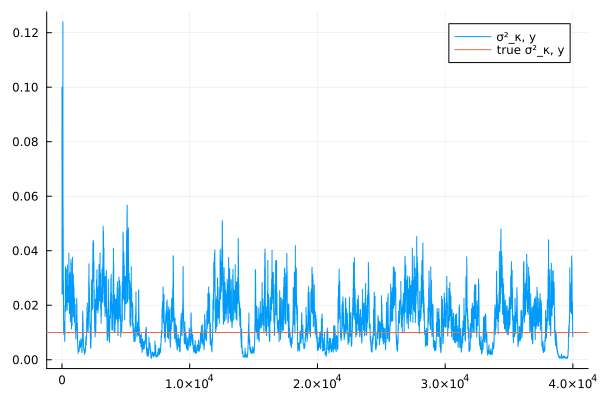

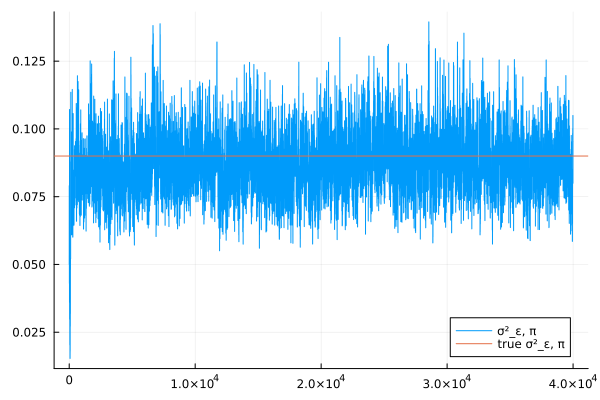

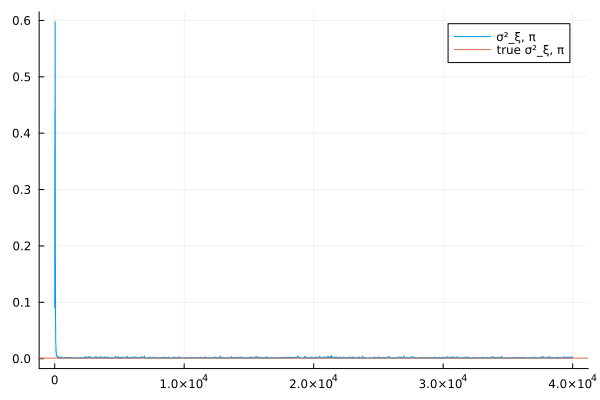

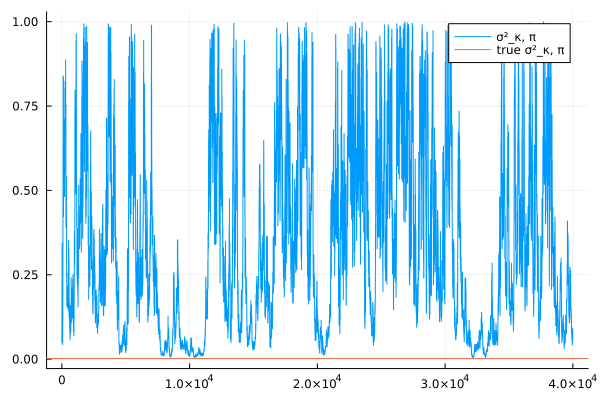

Initial chain shape: (40000, 10)


In [19]:
println("Initial chain shape: ", size(θ_chain_init))
#Print trace plot and add true value
for i in 1:size(θ_chain_init, 2)
    plot(θ_chain_init[:,i], label="$(θ_elements[i])")
    hline!([θ_true[i]], label="true $(θ_elements[i])")
    display(plot!())
end

Rec chain shape: (10000, 10)


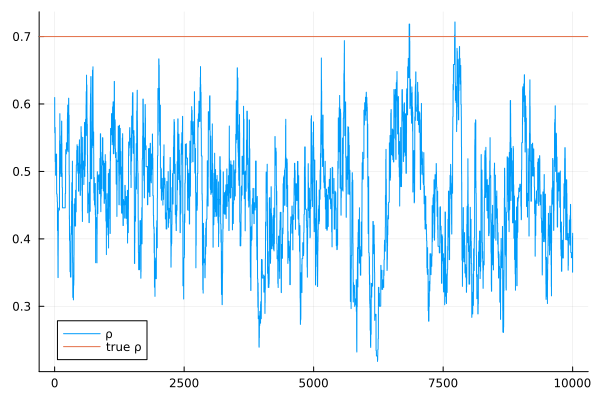

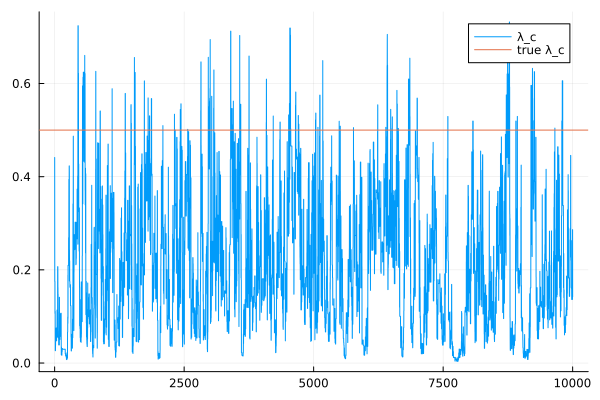

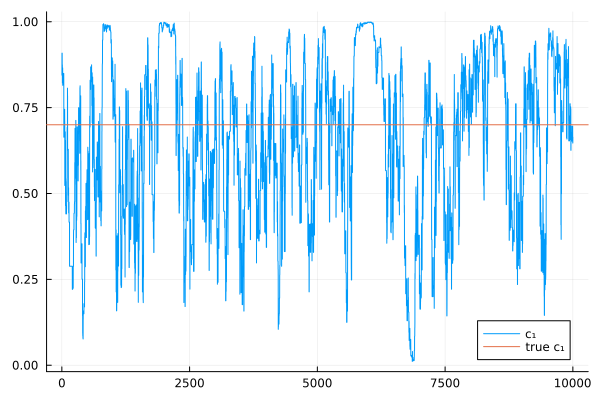

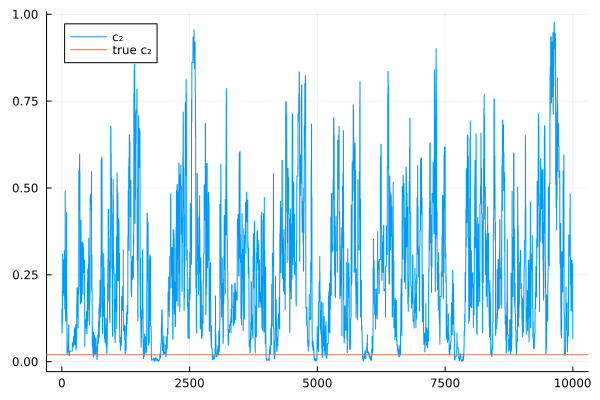

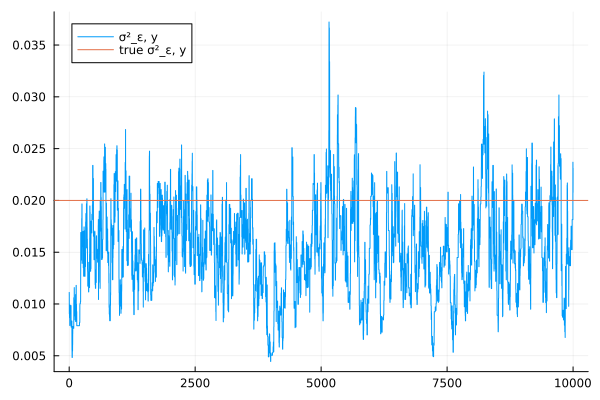

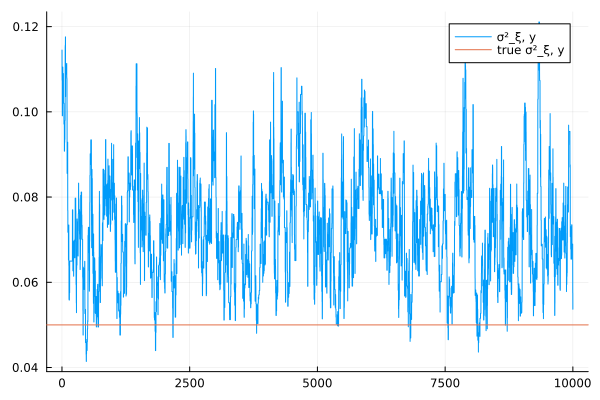

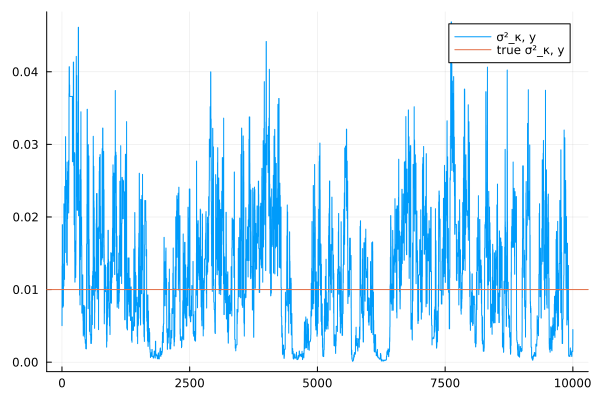

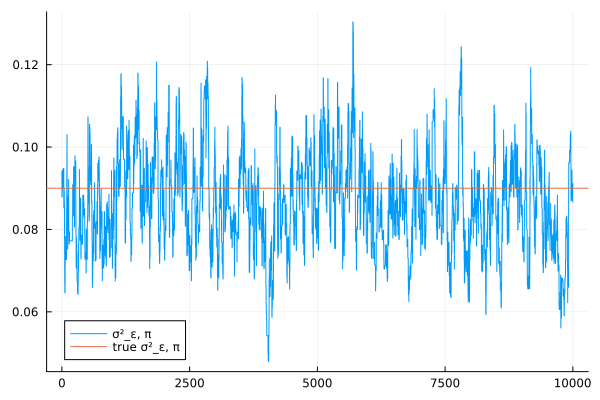

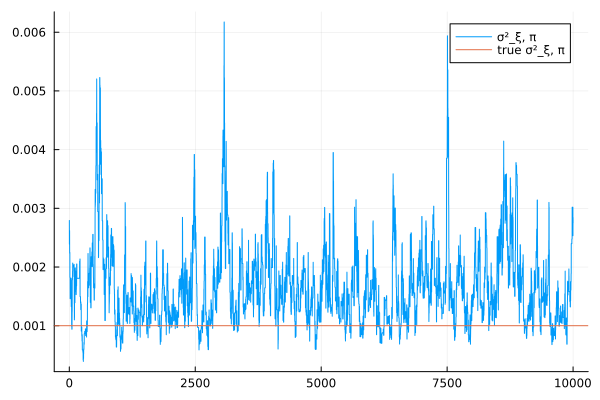

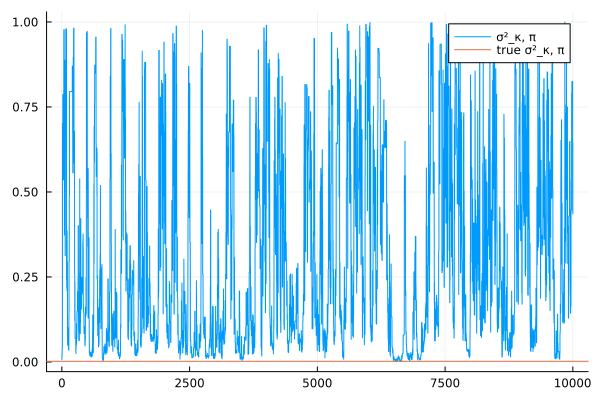

In [20]:
println("Rec chain shape: ", size(θ_chain))

#Print trace plot and add true value
for i in 1:size(θ_chain, 2)
    plot(θ_chain[:,i], label="$(θ_elements[i])")
    hline!([θ_true[i]], label="true $(θ_elements[i])")
    display(plot!())
end



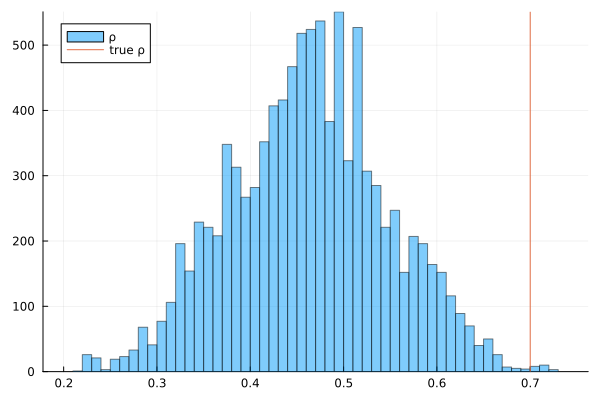

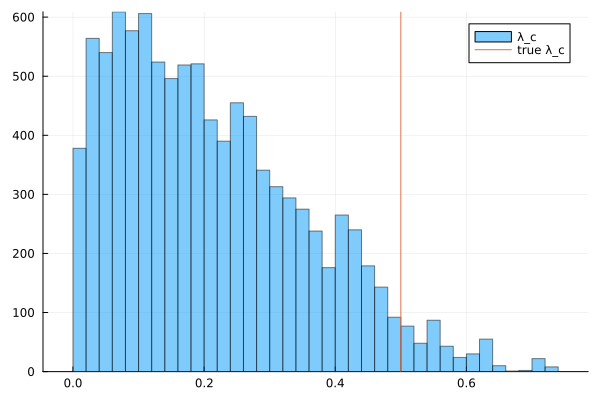

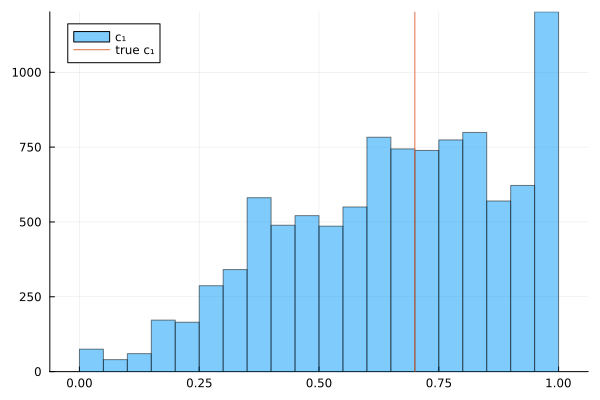

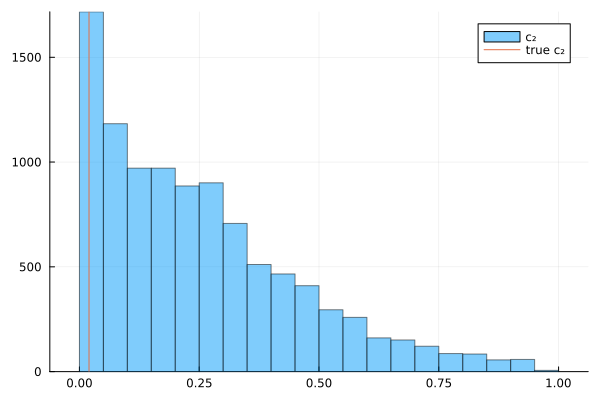

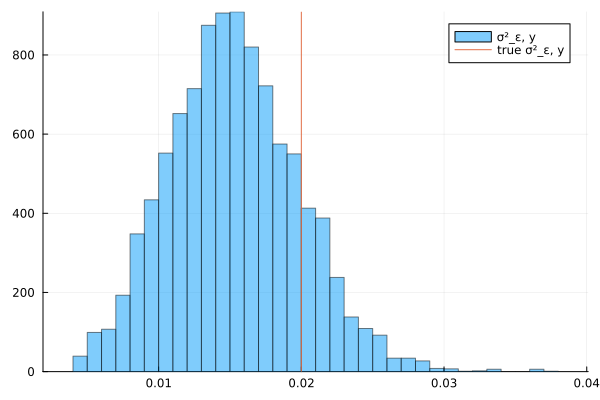

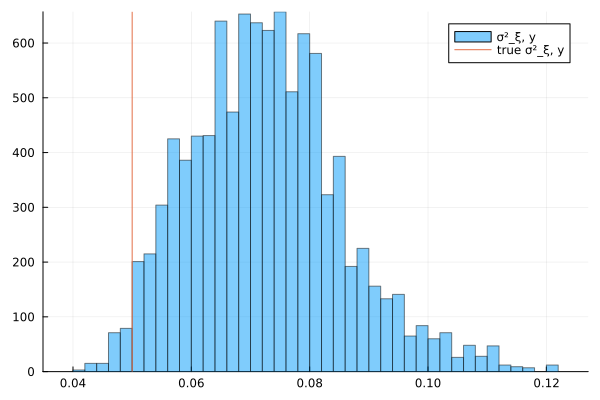

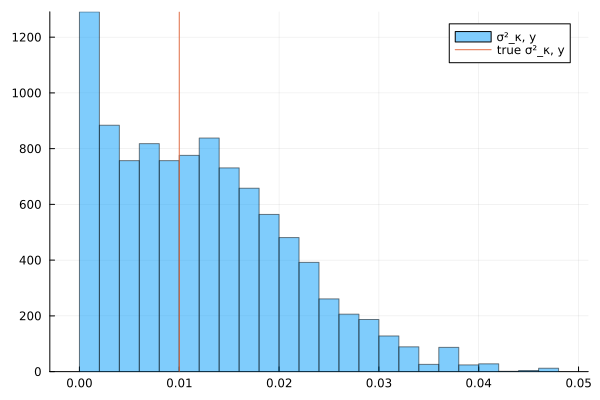

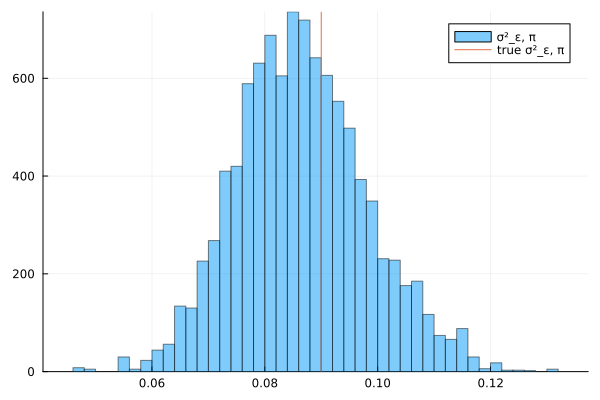

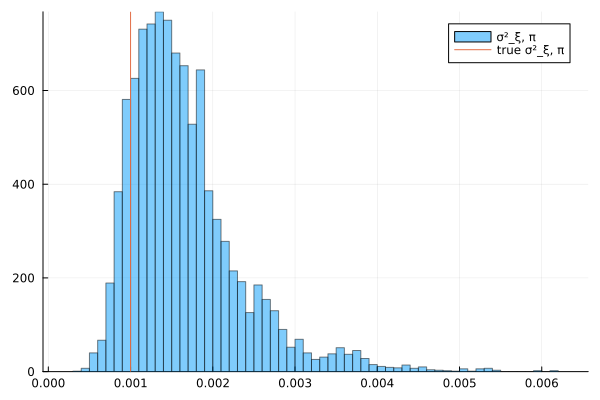

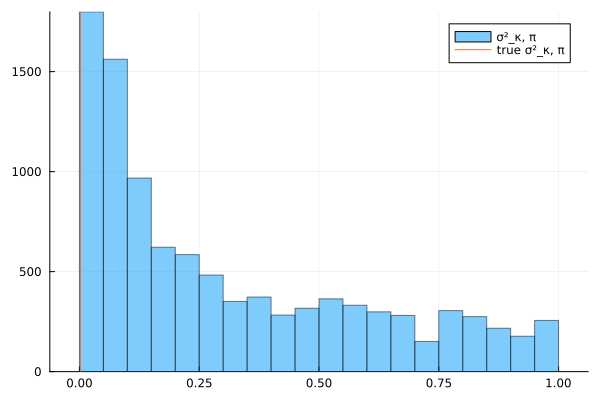

In [21]:
# plot histograms of the chains and add line at true value
for i in 1:size(θ_chain, 2)
    histogram(θ_chain[:,i], label="$(θ_elements[i])", alpha=0.5)
    vline!([θ_true[i]], label="true $(θ_elements[i])")
    display(plot!())
end

Mean of α_draws: (1, 14, 300)


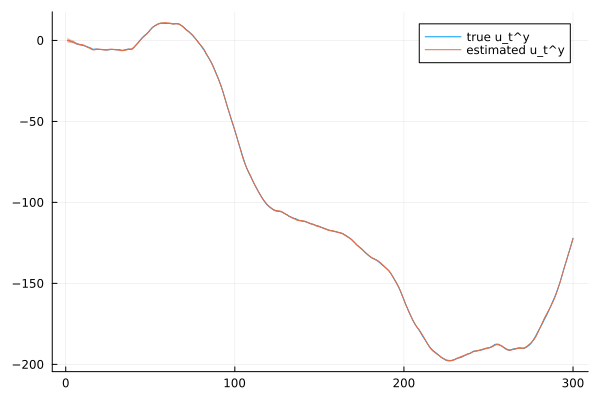

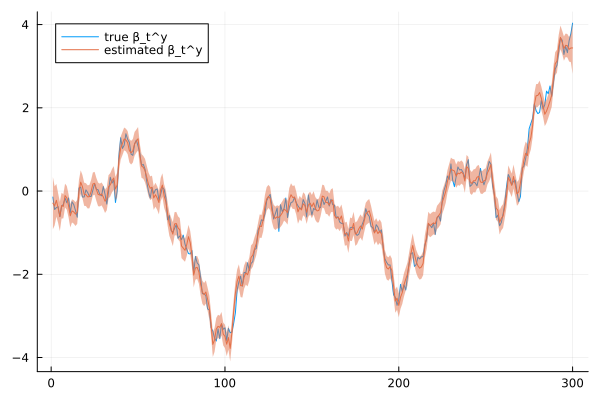

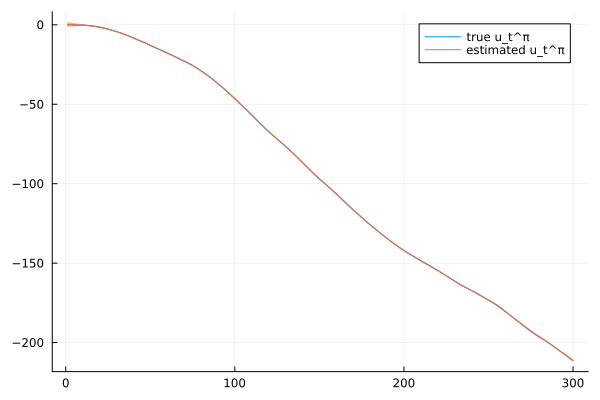

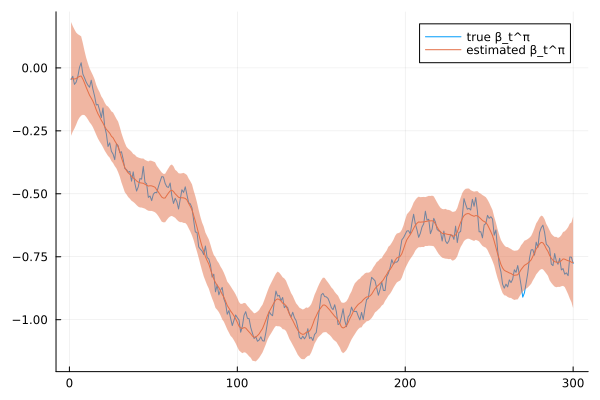

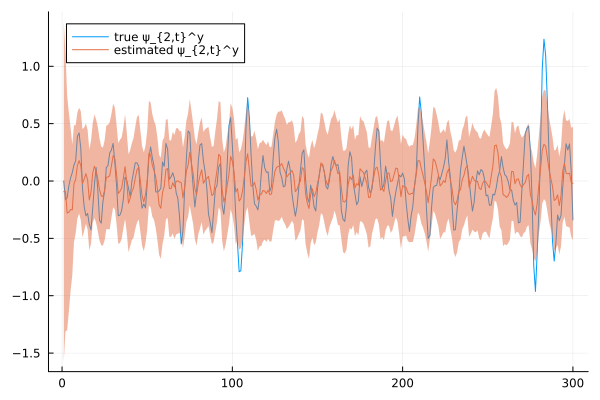

...

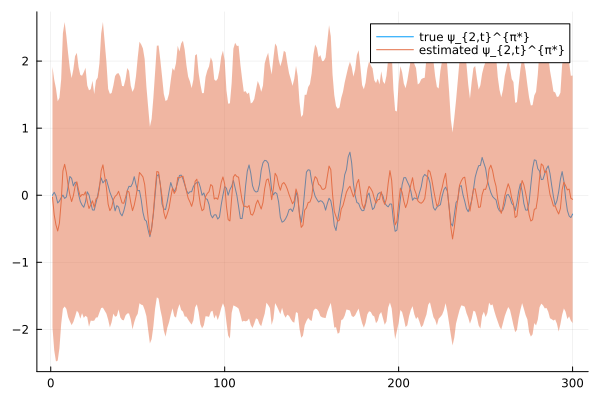

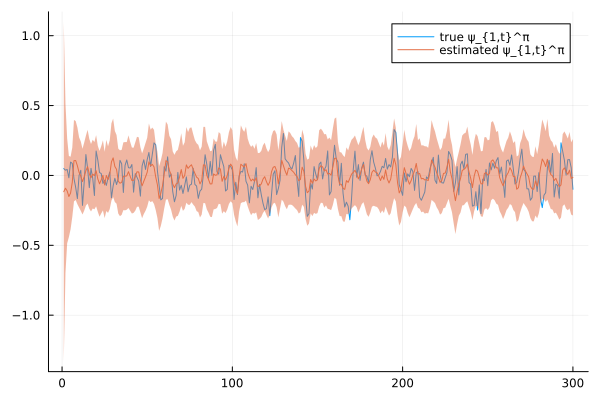

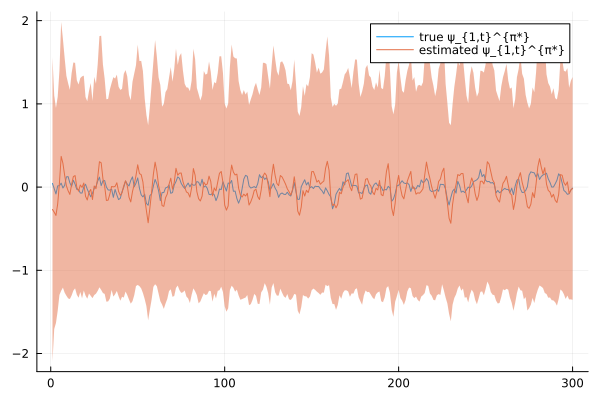

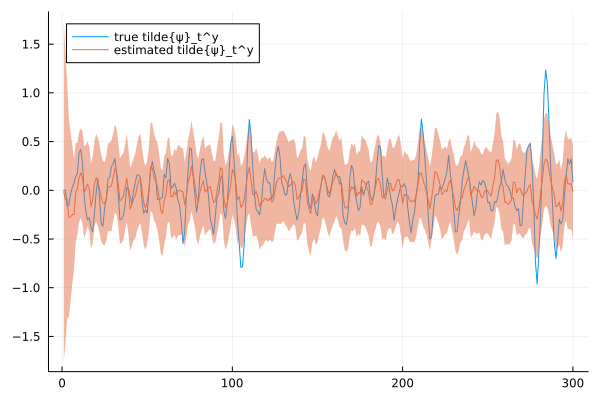

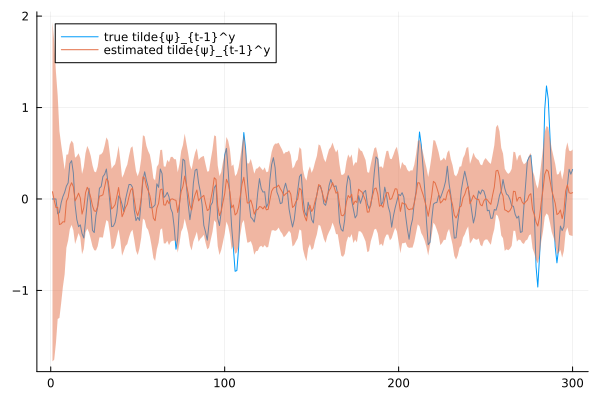

In [22]:
# Compute the mean over iterations (dimension 1)
α_mean = mean(α_draws, dims=1)
println("Mean of α_draws: ", size(α_mean))

# Compute the 2.5% and 97.5% quantiles 
α_ci = mapslices(x -> quantile(x, [0.025, 0.975]), α_draws, dims=1)



# Plot true states, mean of states, and confidence intervals of states
for i in 1:size(α_mean, 2)
    plot(α[i, :], label="true $(α_elements[i])")
    plot!(α_mean[1, i, :], ribbon=(α_ci[2, i, :] .- α_mean[1, i, :]), label="estimated $(α_elements[i])")
    display(plot!())
end


## MLE

In [23]:
# using Optim

# # # True parameters
# # ρ = 0.9
# # λ_c = 0.1
# # c₁ = 0.1
# # c₂ = 0.1
# # v_ε = 1e-4
# # v_ξ = 1e-4
# # v_κ = 1e-4  
# # σ²_ε_y = 0.3
# # σ²_ξ_y = 0.5
# # σ²_κ_y = 0.8
# # σ²_ε_π = 0.01
# # σ²_ξ_π = 0.07
# # σ²_κ_π = 0.03


# lower_bounds = [0.0, 0.0, 0.0, 0.0, 0.0, 0, 0, 0, 0, 0, 0, 0, 0]
# upper_bounds = [1.0, 3.0, 3.0, 3.0, 3.0, 1, 1, 1, 1, 1, 1, 1, 1]
# θ_init = θ_true 
# objective(θ) = neg_log_likelihood(θ, obs, α0, P0, cycle_order)
# res = optimize(objective, lower_bounds, upper_bounds, θ_init, Fminbox(BFGS()))

# # Extract the estimated parameters
# θ_est = Optim.minimizer(res)

# # Print the results:
# println("\nMLE Results (with bounded optimization):")
# for (i, param_name) in enumerate(θ_elements)
#     println("Estimated $(param_name): $(θ_est[i])   (True value: $(θ_true[i]))")
# end
# println("\nFinal negative log-likelihood: ", Optim.minimum(res))


In [24]:
# # estimate states
# LogL_diff, α_diff, P_diff = diffuse_kalman_filter(obs, θ_est, α0, P0, cycle_order, true, false)

# #plot estimated states and true states
# for i in 1:size(α,2)
#     plot(α[:,i], label="true $(α_elements[i])")
#     plot!(α_diff[:,i], label="estimated $(α_elements[i])")
#     display(plot!())
# end

